# Librairies

In [1]:
import pandas as pd 
import geopandas as gpd
import matplotlib.pylab as plt
import numpy as np

# Data

In [2]:
df = gpd.read_file('raw/geojson_lnglat.php.json')

In [3]:
df.columns

Index(['LABEL', 'linknr', 'modeljaar', 'naam', 'etmaal', 'daglv', 'avondlv',
       'nachtlv', 'dagmv', 'avondmv', 'nachtmv', 'dagzv', 'avondzv', 'nachtzv',
       'dagmr', 'avondmr', 'nachtmr', 'geometry'],
      dtype='object')

In [5]:
df.columns = [
    'LABEL', 'link_number', 'model_year', 'name', 'daily_total', 
    'day_light_vehicles', 'evening_light_vehicles', 'night_light_vehicles', 
    'day_medium_vehicles', 'evening_medium_vehicles', 'night_medium_vehicles', 
    'day_heavy_vehicles', 'evening_heavy_vehicles', 'night_heavy_vehicles', 
    'day_motorcycles', 'evening_motorcycles', 'night_motorcycles', 
    'geometry'
]

In [6]:
df.model_year.unique()

array([2019, 2025, 2030, 2035, 2040, 2050])

In [7]:
df[[ 'day_light_vehicles', 'evening_light_vehicles', 'night_light_vehicles', 
    'day_medium_vehicles', 'evening_medium_vehicles', 'night_medium_vehicles', 
    'day_heavy_vehicles', 'evening_heavy_vehicles', 'night_heavy_vehicles', 
    'day_motorcycles', 'evening_motorcycles', 'night_motorcycles']].sum(axis = 1)

0        566
1        141
2        147
3        145
4        156
        ... 
29562    103
29563    105
29564    108
29565     52
29566     89
Length: 29567, dtype: int64

In [8]:
df['daily_total']
# The daily total does not corerspond to the sum of other columns

0        4995
1        1259
2        1304
3        1283
4        1377
         ... 
29562     901
29563     919
29564     938
29565     470
29566     802
Name: daily_total, Length: 29567, dtype: int32

In [10]:
df.rename(columns = {'daily_total':'AADT', 'name': 'raw_name'}, inplace=True)

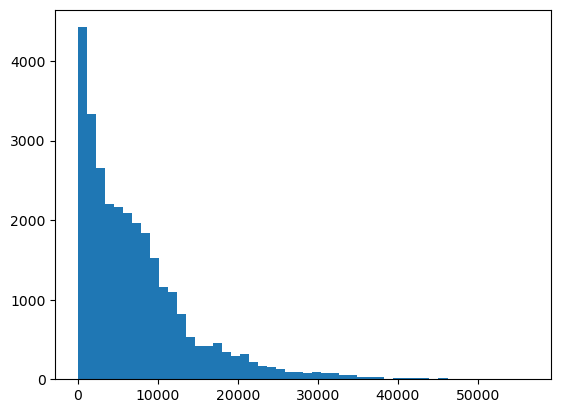

In [11]:
plt.hist(df.AADT, bins = 50)
plt.show()

# Map matching with OSM

In [12]:
import sys
from pathlib import Path

# Add the ../assets directory to sys.path
sys.path.append(str(Path("../../assets").resolve()))

from map_matching_OSM import lines_matching

In [13]:
# 45min
df = lines_matching(df)

Main graph loaded
Node 792731041 not reachable from 1719610485
Node 792731041 not reachable from 1042934479
Node 792731041 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1087365185 not reachable from 1042934479
Node 1087365185 not reachable from 1042934479
<class 'KeyError'> 'target'
Node 792731041 not reachable from 1719610485
Node 792731041 not reachable from 1042934479
Node 792731041 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1087365185 not reachable from 1042934479
Node 1087365185 not reachable from 1042934479
<class 'KeyError'> 'target'
Node 792731041 not reachable from 1719610485
Node 792731041 not reachable from 1042934479
Node 792731041 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1434469013 not reachable from 1042934479
Node 1087365185 not reachable from 1042934479
Node 1087365185

In [17]:
df[['Street_name', 'osm_name']].drop_duplicates()[:20]

,Street_name,osm_name
0,Tom Schreursweg,Tom Schreursweg
6,Ookmeerweg,Ookmeerweg
12,Osdorperweg,Osdorperweg
18,Heining,Heining
24,Joris van den Berghweg,Joris van den Berghweg
30,Tom Schreursweg,NaN
42,Kwelderweg,Kwelderweg
48,Osdorper Ban,Osdorper Ban
54,Ingelandenweg,Ingelandenweg
72,Dortmuiden,Dortmuiden


# Final saving

In [19]:
df.rename(columns = {'Street_name': 'raw_name'}, inplace=True)

In [23]:
for year in [2019, 2025]:
    df[df.model_year == year][['AADT', 'geometry', 'raw_name', 'osm_name', 'osm_lanes', 'osm_type', 'osm_oneway', 'osmid']].to_file(
        f'treated/Amsterdam_AADT_{year}.geojson'
    )

# Illustration

In [68]:
from matplotlib.colors import LogNorm

In [73]:
df.AADT.describe()

count    29567.000000
mean      7411.729124
std       7161.234739
min          0.000000
25%       2102.000000
50%       5635.000000
75%      10112.000000
max      56375.000000
Name: AADT, dtype: float64

<AxesSubplot: >

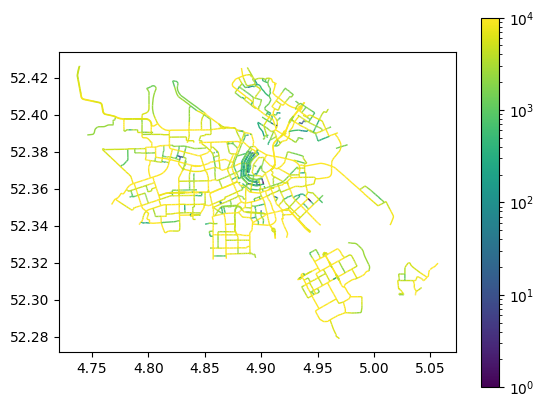

In [87]:
df[(df.model_year == 2019) ].plot('AADT', legend = True, 
                                                  norm = LogNorm(1, 10000),
                                                  lw = 1
                                                  )

<AxesSubplot: >

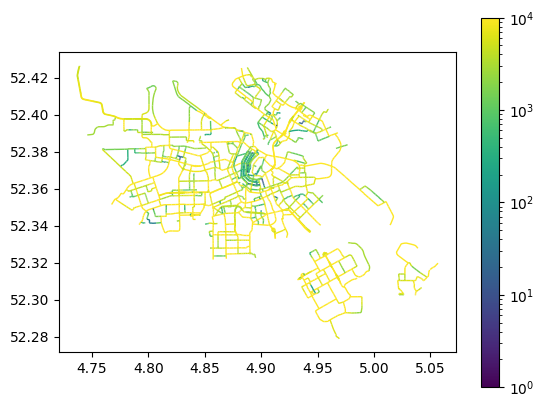

In [86]:
df[(df.model_year == 2050) ].plot('AADT', legend = True, 
                                                  norm = LogNorm(1, 10000),
                                                  lw = 1
                                                  )

In [41]:
df.set_index(['link_number'], inplace=True)

In [64]:
(df[df.model_year == 2025].AADT - df[df.model_year == 2019].AADT).isna().sum()

9864